In [1]:
import folium
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
#from bs4 import BeautifulSoup
#import requests
from folium import plugins
from folium.plugins import MeasureControl
from branca.colormap import linear
from branca import colormap
from branca import colormap as cm

In [2]:
folium.__version__

'0.11.0'

## Folium Map-Stamen Watercolor

In [3]:
folium.Map(location=[41,29],tiles="Stamen Watercolor",width="%100",height="%100",zoom_start=10)
 

In [4]:
folium.Map(location=[41,29])

In [5]:
folium.Map?

## Folium Map Stamen Toner

In [6]:
folium.Map(location=[41,29],tiles="Stamen Toner",width="%100",height="%100",zoom_start=10)


## Folium Map-Circle

In [7]:
m = folium.Map(location=[41,29],tiles="Stamen Toner",width="%100",height="%100",zoom_start=10)
folium.Circle(
    radius=5000,
    location=[41,29],
    color='crimson',
    fill=False,
).add_to(m)
m

## Folium Map Circle Marker

In [8]:
m = folium.Map(location=[41,29],tiles="Stamen Toner",width="%100",height="%100")
folium.CircleMarker(location=(41,29),radius=100, fill_color='red').add_to(m)
m

## Folium Map -Marker

In [9]:

m = folium.Map(location=[40.75834,30.38001])
folium.Marker(location=[40.75834,30.38001], popup = 'Sakarya').add_to(m)
folium.CircleMarker(location=(40.75834,30.38001),radius=100, fill_color='blue').add_to(m)
m

In [10]:
data_abone=pd.read_excel("ilcelere-gore-abone-sayilari.xlsx",sheet_name="İlçe Abone Sayı")
data_abone.head()

,İLÇE,ABONE SAYI
0,Adalar,8486
1,Arnavutköy,90340
2,Ataşehir,169413
3,Avcılar,155530
4,Bağcılar,232332


In [11]:
data_koordinat=pd.read_excel("ilcelere-gore-abone-sayilari.xlsx",sheet_name="Koordinatlar")
data_koordinat.head()

,İLÇE,Enlem,Boylam
0,Adalar,40.8691,29.1206
1,Arnavutköy,41.1967,28.734
2,Ataşehir,40.991,29.1347
3,Avcılar,41.0236,28.7186
4,Bağcılar,41.0427,28.8362


## Marker Cluster

In [12]:
m = folium.Map([42 ,29], zoom_start=5,width="%100",height="%100")
location=data_koordinat[["Enlem","Boylam"]]

plugins.MarkerCluster(location).add_to(m)

m

In [13]:
data=pd.merge(data_abone,data_koordinat)
df=data.copy()

In [14]:
df.head()

,İLÇE,ABONE SAYI,Enlem,Boylam
0,Adalar,8486,40.8691,29.1206
1,Arnavutköy,90340,41.1967,28.734
2,Ataşehir,169413,40.991,29.1347
3,Avcılar,155530,41.0236,28.7186
4,Bağcılar,232332,41.0427,28.8362


In [15]:
m = folium.Map([42 ,29], zoom_start=5,width="%100",height="%100")
locations = list(zip(df.Enlem, df.Boylam))
icons = [folium.Icon(icon="airbnb", prefix="fa") for i in range(len(locations))]

cluster = plugins.MarkerCluster(locations=locations, icons=icons,popups=df["İLÇE"].tolist())
m.add_child(cluster)
m

In [16]:
df.dtypes

İLÇE          object
ABONE SAYI     int64
Enlem         object
Boylam        object
dtype: object

In [17]:
df.Enlem=df.Enlem.astype(float)
df.Boylam=df.Boylam.astype(float)

In [18]:
heat_df=df[["Enlem","Boylam"]]

In [19]:
heat_data=list(zip(df.Enlem, df.Boylam))

## HEATMAP

In [20]:
folium.plugins.HeatMap(heat_data).add_to(m)
m

In [21]:
m = folium.Map([42 ,29], zoom_start=5,width="%100",height="%100")
heat_data = df.groupby(["Enlem","Boylam"])['ABONE SAYI'].sum().reset_index().values.tolist()
folium.plugins.HeatMap(heat_data).add_to(m)
m

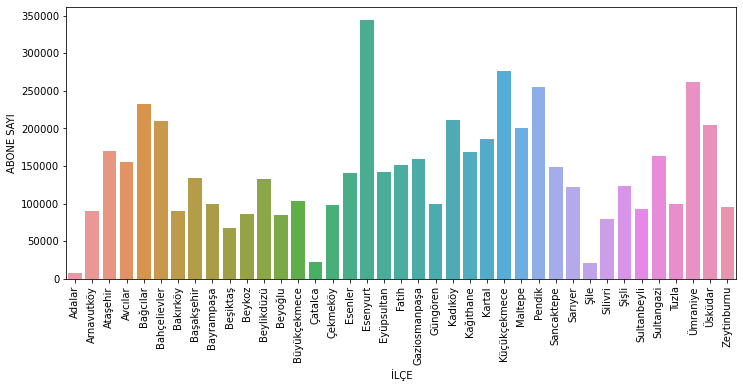

In [22]:
plt.figure(figsize=(12,5))
sns.barplot(x="İLÇE",y="ABONE SAYI",data=df)
plt.xticks(rotation=90);

## Minimap Ekleme

In [23]:
m = folium.Map(location=(42, 29), zoom_start=6)

minimap = plugins.MiniMap()
m.add_child(minimap)
m

## GEOJSON

In [24]:
geo=r"C:\Users\ASUS\Desktop\tr-cities.json"
file = open(geo, encoding="utf8")
text = file.read()

In [25]:

from folium import GeoJson
m = folium.Map(width="%100",weight="%100")

GeoJson(text).add_to(m)
m

In [26]:
from folium import GeoJson

m = folium.Map(tiles="Stamen Toner")

GeoJson(text,
       style_function=lambda feature: {
        'fillColor': '#adff2f',  #7b68ee         
        'color':None, #'color': 'red',
        'weight': 1,
        'dashArray': '4, 4'
    }).add_to(m)
m

In [27]:
m = folium.Map(tiles="Cartodb dark_matter",width="%100",weight="%100")

GeoJson(text,).add_to(m)
m

In [28]:
nufus=pd.read_excel(r"pivot.xls")

In [29]:
nufus.drop("Unnamed: 2",axis=1,inplace=True)

In [30]:
nufus.drop(nufus[nufus["Sehir"]=="Yurtdışı"].index,inplace=True)
nufus.drop(nufus[nufus["Sehir"]=="Bilinmeyen"].index,inplace=True)
nufus.head()

,Sehir,Nufus
0,Adana,2132691
1,Adıyaman,927714
2,Afyonkarahisar,924298
3,Ağrı,951036
4,Aksaray,491902


In [31]:

nufus.loc[nufus["Sehir"]=="Afyonkarahisar","Sehir"]="Afyon"

In [32]:
nufus.dtypes

Sehir    object
Nufus     int64
dtype: object

In [33]:
nufus["Nufus"].describe()

count    8.100000e+01
mean     9.768048e+05
std      1.062662e+06
min      1.194440e+05
25%      4.001970e+05
50%      6.853870e+05
75%      1.224531e+06
max      8.378878e+06
Name: Nufus, dtype: float64

In [34]:
min_nufus=nufus["Nufus"].min()
max_nufus=nufus["Nufus"].max()
colormap = colormap.LinearColormap(colors=['green','yellow','orange','red'] ,
                             index=[min_nufus,1200000,4000000,max_nufus],
                             vmin=min_nufus ,
                             vmax=max_nufus)

In [35]:
colormap

In [36]:
#folium.Choropleth?

In [37]:
m = folium.Map([42 ,29],tiles="Cartodb Positron", zoom_start=5,width="%100",height="%100")
folium.Choropleth(
    geo_data=text,
    data=nufus,
    columns=['Sehir', 'Nufus'],   
    legend_name='Dogum Yerine Gore Nufus (2019)',
    key_on='feature.properties.name', # Ex: ‘feature.id’ or ‘feature.properties.statename’.
    ).add_to(m)

m

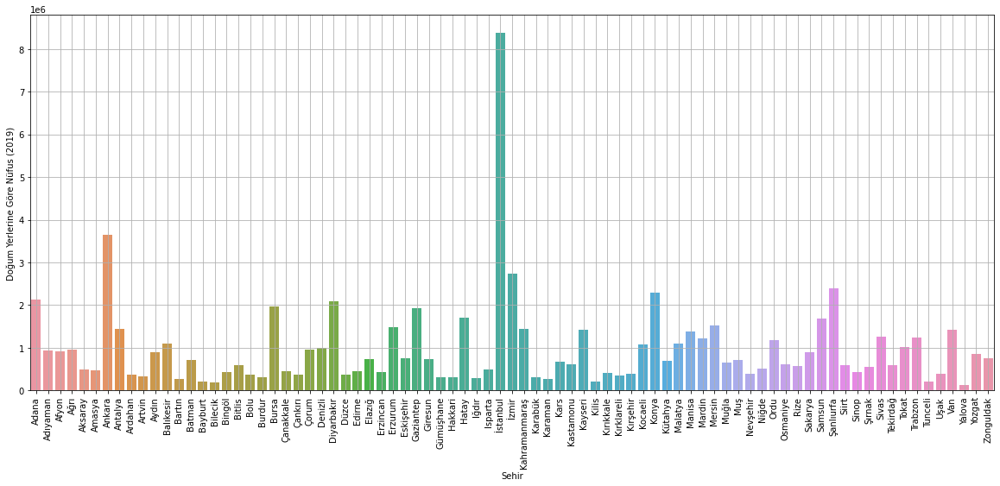

In [38]:
plt.figure(figsize=(20,8))
sns.barplot(x="Sehir",y="Nufus",data=nufus)
plt.xticks(rotation=90);
plt.ylabel("Doğum Yerlerine Göre Nüfus (2019)");
plt.grid();

In [39]:
airbnb_data=pd.read_csv("airbnbIstanbul.csv")

In [40]:
airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,4826,The Place,6603,Kaan,NaN,Uskudar,41.05650,29.05367,Entire home/apt,554,1,1,2009-06-01,0.01,1,365
1,20815,The Bosphorus from The Comfy Hill,78838,Gülder,NaN,Besiktas,41.06984,29.04545,Entire home/apt,100,30,41,2018-11-07,0.38,2,49
2,25436,House for vacation rental furnutare,105823,Yesim,NaN,Besiktas,41.07731,29.03891,Entire home/apt,211,21,0,NaN,NaN,1,83
3,27271,LOVELY APT. IN PERFECT LOCATION,117026,Mutlu,NaN,Beyoglu,41.03220,28.98216,Entire home/apt,237,5,2,2018-05-04,0.04,1,228
4,28277,Duplex Apartment with Terrace,121607,Alen,NaN,Sisli,41.04471,28.98567,Entire home/apt,591,3,0,NaN,NaN,13,356


In [41]:
airbnb_data.isnull().sum().to_frame()

,0
id,0
name,91
host_id,0
host_name,7
neighbourhood_group,16251
neighbourhood,0
latitude,0
longitude,0
room_type,0
price,0


In [42]:
airbnb_data.eq(0).sum()

id                                   0
name                                 0
host_id                              0
host_name                            0
neighbourhood_group                  0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                3
minimum_nights                       0
number_of_reviews                 8484
last_review                          0
reviews_per_month                    0
calculated_host_listings_count       0
availability_365                  1616
dtype: int64

In [43]:
m = folium.Map([42 ,29], zoom_start=5,width="%100",height="%100")
locations = list(zip(airbnb_data.latitude, airbnb_data.longitude))
#icons = [folium.Icon(icon="airbnb", prefix="fa") for i in range(len(locations))]

cluster = plugins.MarkerCluster(locations=locations,popups=airbnb_data["neighbourhood"].tolist())
m.add_child(cluster)
m

In [44]:
m = folium.Map(location=[41,29],width="%100",height="%100")
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(m)
m

In [45]:
airbnb=airbnb_data[["latitude","longitude","price"]]

In [46]:
min_price=airbnb_data["price"].min()
max_price=airbnb_data["price"].max()
min_price,max_price

(0, 59561)

In [47]:
airbnb["price"].describe().to_frame()

,price
count,16251.000000
mean,354.723894
std,1428.938340
min,0.000000
25%,105.000000
50%,190.000000
75%,327.000000
max,59561.000000


In [48]:
m = folium.Map(location=[41,29],width="%100",height="%100")
#colormap = cm.LinearColormap(['green', 'yellow', 'red'],vmin=min_price, vmax=max_price)
colormap = cm.StepColormap(colors=['green','yellow','orange','red'] ,index=[min_price,105,190,327,max_price],vmin= min_price,vmax=max_price)
#cm.LinearColormap.to_step
for loc, p in zip(zip(airbnb["latitude"],airbnb["longitude"]),airbnb["price"]):
    folium.Circle(
        location=loc,
        radius=2,
        fill=True,
        color=colormap(p),
        #popup=
        #fill_opacity=0.7
    ).add_to(m)
#colormap.caption = 'Colormap Caption'
#m.add_child(colormap)

m

In [49]:
airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,4826,The Place,6603,Kaan,NaN,Uskudar,41.05650,29.05367,Entire home/apt,554,1,1,2009-06-01,0.01,1,365
1,20815,The Bosphorus from The Comfy Hill,78838,Gülder,NaN,Besiktas,41.06984,29.04545,Entire home/apt,100,30,41,2018-11-07,0.38,2,49
2,25436,House for vacation rental furnutare,105823,Yesim,NaN,Besiktas,41.07731,29.03891,Entire home/apt,211,21,0,NaN,NaN,1,83
3,27271,LOVELY APT. IN PERFECT LOCATION,117026,Mutlu,NaN,Beyoglu,41.03220,28.98216,Entire home/apt,237,5,2,2018-05-04,0.04,1,228
4,28277,Duplex Apartment with Terrace,121607,Alen,NaN,Sisli,41.04471,28.98567,Entire home/apt,591,3,0,NaN,NaN,13,356


In [50]:
m = folium.Map(location=[41,29],width="%100",height="%100")
airbnb=airbnb_data[["latitude","longitude","price"]]
heat_data = airbnb.groupby(["latitude","longitude"])['price'].mean().reset_index().values.tolist()
folium.plugins.HeatMap(heat_data).add_to(m)
m